In [ ]:
import torch.nn as nn
import torch.optim as optim
import torch
from torch.utils.data import DataLoader

from imports.imageDataset import ImageDataset
from imports.model_architectures import SimpleCNN

import matplotlib.pyplot as plt

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [13]:
#definindo classes
classes = ['dog','man','woman','child','water','ball','car','snow']
class2label = {classes[i]:i for i in range(len(classes))}
label2class = {i:classes[i] for i in range(len(classes))}

#carregando modelos
simple_model = torch.load('./models/flickrcnn.pt', weights_only=False)
resnet_model = torch.load('./models/resnet_based.pt', weights_only=False)

#carregando dataset
whole_train_data = torch.load('./data/processed/train_subset.pt', weights_only=False)
test_dataset = torch.load('./data/processed/test_subset.pt', weights_only=False)
train_dataset, val_dataset= torch.utils.data.random_split(whole_train_data, [0.8, 0.2])

## Fazendo os loaders
batch_size = 32
num_workers = 4

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True,
                          num_workers=num_workers, pin_memory=True)
val_loader   = DataLoader(val_dataset,   batch_size=batch_size, shuffle=False,
                          num_workers=num_workers, pin_memory=True)
test_loader   = DataLoader(test_dataset,   batch_size=batch_size, shuffle=False,
                          num_workers=num_workers, pin_memory=True)

In [8]:
import numpy as np
def get_acc_per_class(model,loader):
  acc_count = np.zeros(len(classes)) ## conta casos em que pred==truelabel (acertou predizendo a classe X)
  error_count = np.zeros(len(classes)) ## conta casos em que predizeu X e a classe era Y, nesse caso error_count[X]+=1 (errou predizendo a classe X)
  total_class_count = np.zeros(len(classes))
  
  for images, labels_true, captions in loader:
    images = images.to(device, non_blocking=True)

    outputs = model(images)
    _, preds = torch.max(outputs, dim=1)

    for i,label_true in enumerate(labels_true):
      if int(label_true) == int(preds[i]):
        acc_count[label_true]+=1
      else:
        error_count[int(preds[i])]+=1
      total_class_count[label_true]+=1
    acc_count /= total_class_count
    error_count /= sum(error_count) ## normaliza para todas as predições
  return acc_count,error_count ## (acurácia por classe , proporções de predições feitas erradas por classe)

In [9]:
def plot_acc_per_class(model,loaders:list):
  """
  Plota o gráfico de acurácia por classe para os dados de treino, validação e teste.
  Args:
    loaders (list): lista de loaders (train_loader, val_loader, test_loader)
    dfs (list): lista de dataframes (df_train, df_val, df_test)
  """
  fig,axs = plt.subplots(2,3,figsize=(6*3,4*2))
  plt.title("Acurácia e erro por classe")

  train_acc_perclass,train_error_perclass = get_acc_per_class(model,train_loader)
  ax = axs[0][0]
  ax.set_title("Acertou predizendo [train]")
  ax.bar(np.arange(len(classes)),train_acc_perclass)
  ax.set_ylabel("% de acerto")
  ax.set_xticks(np.arange(len(classes)),classes)
  ax = axs[1][0]
  ax.set_title("Errou predizendo [train]")
  ax.bar(np.arange(len(classes)),train_error_perclass)
  ax.set_ylabel("proporção da predição")
  ax.set_xticks(np.arange(len(classes)),classes)

  val_acc_perclass,val_error_perclass = get_acc_per_class(model,val_loader)
  ax = axs[0][1]
  ax.set_title("Acertou predizendo [val]")
  ax.bar(np.arange(len(classes)),val_acc_perclass)
  ax.set_ylabel("% de acerto")
  ax.set_xticks(np.arange(len(classes)),classes)
  ax = axs[1][1]
  ax.set_title("Errou predizendo [val]")
  ax.bar(np.arange(len(classes)),val_error_perclass)
  ax.set_ylabel("proporção da predição")
  ax.set_xticks(np.arange(len(classes)),classes)

  test_acc_perclass,test_error_perclass = get_acc_per_class(model,test_loader)
  ax = axs[0][2]
  ax.set_title("Acertou predizendo [test]")
  ax.bar(np.arange(len(classes)),test_acc_perclass)
  ax.set_ylabel("% de acerto")
  ax.set_xticks(np.arange(len(classes)),classes)
  ax = axs[1][2]
  ax.set_title("Errou predizendo [test]")
  ax.bar(np.arange(len(classes)),test_error_perclass)
  ax.set_ylabel("proporção da predição")
  ax.set_xticks(np.arange(len(classes)),classes)

  plt.show()

  train_labels = [element[1] for element in train_dataset]
  val_labels = [element[1] for element in train_dataset]
  test_labels = [element[1] for element in train_dataset]

  print("\nQuantidade de labels em cada conjunto: ")
  print("Treino   : ",np.unique(train_labels,return_counts=True))
  print("Validação: ",np.unique(test_labels,return_counts=True))
  print("Teste    : ",np.unique(val_labels,return_counts=True))

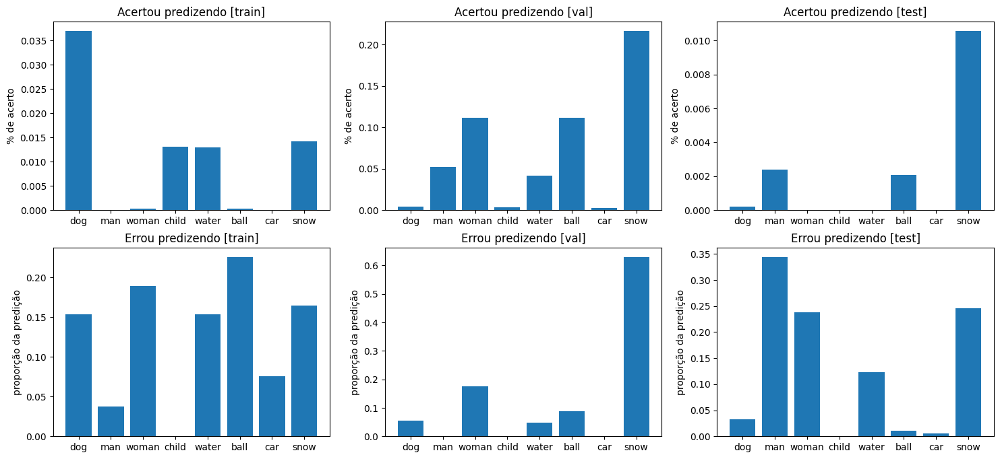


Quantidade de labels em cada conjunto: 
Treino   :  (array([0, 1, 2, 3, 4, 5, 6, 7]), array([82, 85, 84, 76, 78, 85, 76, 74]))
Validação:  (array([0, 1, 2, 3, 4, 5, 6, 7]), array([82, 85, 84, 76, 78, 85, 76, 74]))
Teste    :  (array([0, 1, 2, 3, 4, 5, 6, 7]), array([82, 85, 84, 76, 78, 85, 76, 74]))


In [10]:
plot_acc_per_class(model,(train_loader,val_loader,test_loader))

O modelo está sendo treinado por muito poucas épocas, não é tão potente e não estão sendo feitas técnicas para aumentar a robustez das predições como Data Augmentation, então já era esperado que o modelo não desempenhasse bem. Isso foi praticamente um exemplo didático do funcionamento da cnn.

O dataset é bem complicado, então já é esperado que ele não desempenhe bem, mas aparentemente ele está conseguindo acertar mais da classe 'snow' e 'dog'. Dito isso, vamos tentar usar [Class Activation Map](https://github.com/frgfm/torch-cam) para tentar entender o funcionamento interno da rede.

In [11]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchcam.methods import SmoothGradCAMpp
import numpy as np

def get_cam_img(model,target_layer,input_tensor,threshold=90,alpha = 0.9):
  cam_extractor = SmoothGradCAMpp(model, target_layer=target_layer)
  with torch.enable_grad():
      output = model(input_tensor)
  class_idx = output.squeeze(0).argmax().item()

  activation_maps = cam_extractor(class_idx, output)
  activation_map = activation_maps[0] if isinstance(activation_maps, list) else activation_maps
  if activation_map.ndim == 3 and activation_map.shape[0] == 1:
      activation_map = activation_map.squeeze(0)  # de (1,H,W) para (H,W)

  cam = activation_map.unsqueeze(0).unsqueeze(0)  # (1,1,H,W)
  cam_upsampled = F.interpolate(cam, size=(224,224), mode='bilinear', align_corners=False)
  cam_np = cam_upsampled.squeeze().cpu().detach().numpy()  # (224,224)
  cam_np -= cam_np.min()
  if cam_np.max() > 0:
      cam_np /= cam_np.max()

  img_np = input_tensor.squeeze(0).cpu().detach().numpy().transpose(1,2,0)
  threshold = np.percentile(cam_np, threshold)
  mask = cam_np > threshold

  cmap = plt.cm.viridis
  alpha = np.clip((cam_np - threshold) / (1 - threshold), 0, 1) * 0.6
  heatmap = cmap(cam_np)
  heatmap[..., 3] = mask * alpha
  return img_np,heatmap

## Mostrando por classe como fica a verificação
def get_cams_per_class(model,loader,target_layer,n_perclass = 5,threshold=60,alpha=0.9):
  cam_imgs_per_class = []
  for i in range(len(classes)):
    cam_imgs_per_class.append([])
  loop = True
  loader_iter = iter(loader)
  while loop:
    images_batch, labels_batch, captions_batch = next(loader_iter)
    images_batch = images_batch.to(device, non_blocking=True)
    labels_batch = labels_batch.to(device, non_blocking=True)

    loop = False
    for idx in range(len(images_batch)):
      label = int(labels_batch[idx].cpu())
      if len(cam_imgs_per_class[label]) >= n_perclass: ## já tem o suficiente
        continue

      loop = True
      input_tensor = images_batch[idx].unsqueeze(0).clone().detach().to(device)
      input_tensor.requires_grad_(True)
      caption = captions_batch[idx]
      img_np,heatmap = get_cam_img(model,target_layer,input_tensor,threshold=threshold,alpha = alpha)
      output = model(input_tensor)
      _, pred = torch.max(output, dim=1)
      cam_imgs_per_class[label].append((img_np,heatmap,caption,label,int(pred)))
  return cam_imgs_per_class

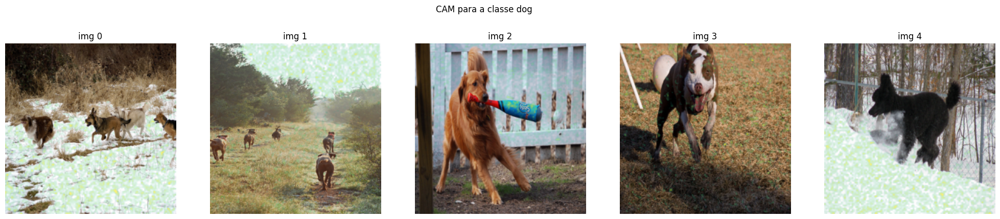

    0 --- true: dog        pred: snow       caption: Four dogs happily running in snow .
    1 --- true: dog        pred: dog        caption: Many dogs are running the same way in a field .
    2 --- true: dog        pred: snow       caption: A long-haired dog is playing with a small , blue bat .
    3 --- true: dog        pred: child      caption: A brown and white dog is running .
    4 --- true: dog        pred: snow       caption: A black dog is playing in the snow .





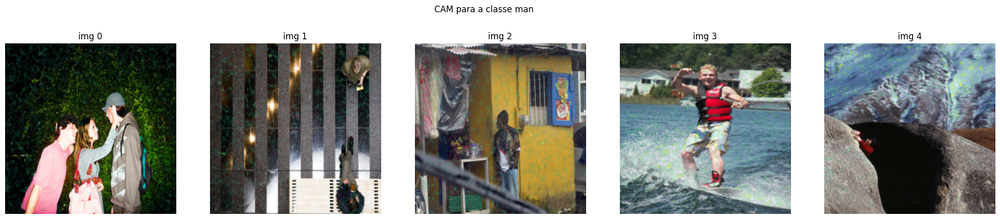

    0 --- true: man        pred: woman      caption: Girl touches young man 's face as young man in pink shirt observes , leafy background .
    1 --- true: man        pred: car        caption: A man sits on a bench while another man walks toward him .
    2 --- true: man        pred: ball       caption: A man is standing outside a yellow building .
    3 --- true: man        pred: snow       caption: A young man rides a wakeboard .
    4 --- true: man        pred: snow       caption: A man climbing a mountain .





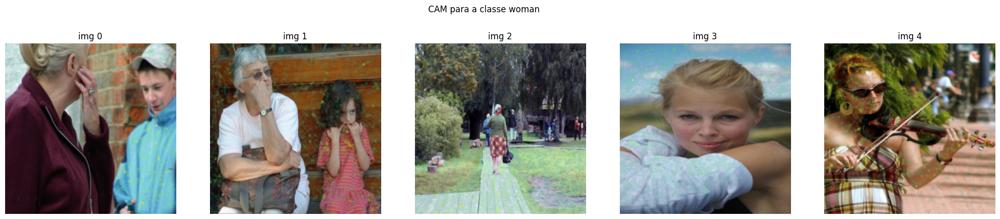

    0 --- true: woman      pred: snow       caption: A woman scratching her face .
    1 --- true: woman      pred: man        caption: An old woman is sitting next to a young girl with her fingers in her mouth .
    2 --- true: woman      pred: snow       caption: The woman wearing the brown skirt is carrying a black bag along a wooden walkway .
    3 --- true: woman      pred: snow       caption: A woman with blonde hair is smiling and putting on a white sweater .
    4 --- true: woman      pred: child      caption: a red haired woman playing the violin





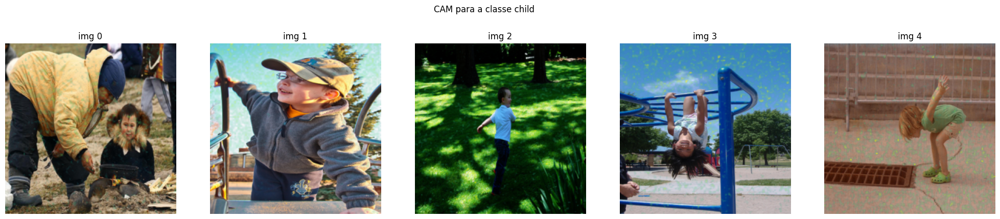

    0 --- true: child      pred: child      caption: a person cooking on a fire while a small child watches .
    1 --- true: child      pred: snow       caption: A child smiles happily as he holds onto a metal bar .
    2 --- true: child      pred: ball       caption: A child runs through the grass .
    3 --- true: child      pred: snow       caption: A child playing on the monkey bars at a playground with an adult present .
    4 --- true: child      pred: dog        caption: A child in green shoes staring down a drain .





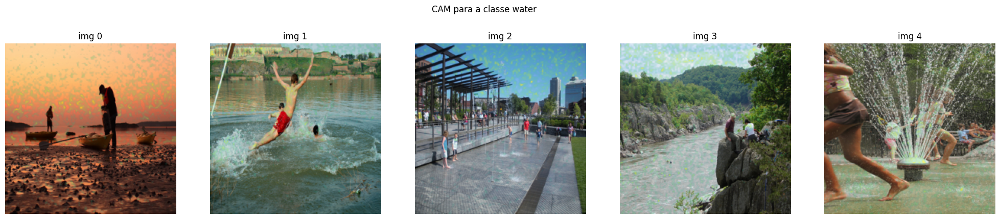

    0 --- true: water      pred: child      caption: People tend canoes at the edge of a body of water during a dimly lit time of day .
    1 --- true: water      pred: dog        caption: A boy in a red suit plays in the water .
    2 --- true: water      pred: snow       caption: People are gathered in a city and barefoot children stand near a water fountain .
    3 --- true: water      pred: dog        caption: A few people sit out on rocks overlooking the water below .
    4 --- true: water      pred: dog        caption: A group of children playing in a water fountain .





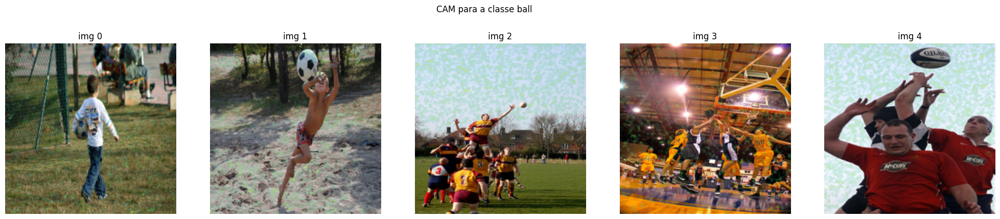

    0 --- true: ball       pred: ball       caption: A boy walks with a ball tucked under his arm .
    1 --- true: ball       pred: dog        caption: A young boy wearing a red bathing suit reaches for a soccer ball .
    2 --- true: ball       pred: snow       caption: A team of soccer players lifts one teammate so that he can reach the ball .
    3 --- true: ball       pred: man        caption: A group of basketball players jump in the air for the ball .
    4 --- true: ball       pred: snow       caption: Three rugby players grab for the ball .





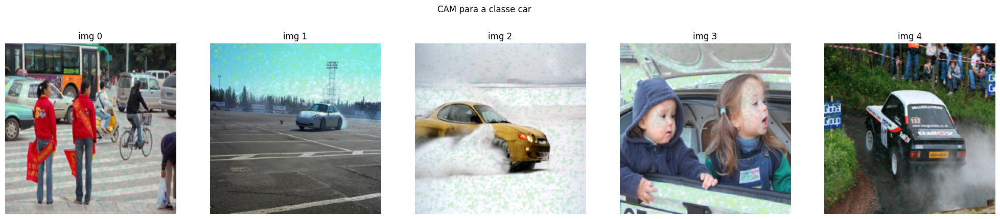

    0 --- true: car        pred: snow       caption: Two girls in red jackets are trying to cross traffic with a lot of cars going by .
    1 --- true: car        pred: snow       caption: A car with white smoke trailing behind it on a black topped surface .
    2 --- true: car        pred: snow       caption: A yellow car drives across a snowy path .
    3 --- true: car        pred: snow       caption: Two small children pop their heads out of the trunk of a car in cold weather .
    4 --- true: car        pred: water      caption: The black and white race car is going fast around the track while fans watch nearby .





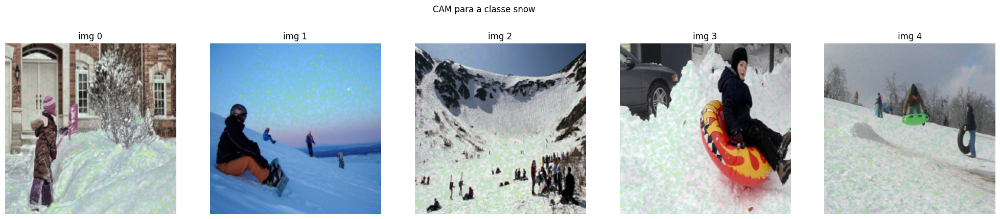

    0 --- true: snow       pred: snow       caption: A warmly dressed person is shoveling snow outside a house .
    1 --- true: snow       pred: snow       caption: Snowboarders sitting in the snow while skiers take the hill .
    2 --- true: snow       pred: snow       caption: Some people hanging out in the snow .
    3 --- true: snow       pred: snow       caption: This person , bundled up for the snow , slides down the hill on an intertube .
    4 --- true: snow       pred: snow       caption: A boy riding a sled off of a snow ramp .





In [ ]:
n_perclass = 5
figsize = (5,5)
cam_imgs_per_class = get_cams_per_class(simple_model,train_loader,n_perclass = n_perclass,target_layer='block1')

for class_idx, cams_imgs in enumerate(cam_imgs_per_class):
  fig,axs = plt.subplots(1,5,figsize=(figsize[0]*n_perclass,figsize[1]*1))

  ## mostra as imagens nos ax
  for img_count, (img_np,heatmap,caption,label,pred) in enumerate(cams_imgs):
    ax = axs[img_count]
    ax.imshow(img_np)
    ax.imshow(heatmap)
    ax.set_title(f"img {img_count}")
    ax.axis('off')
  fig.suptitle(f"CAM para a classe {label2class[class_idx]}")
  plt.show()

  ## printa as captions e labels e preds
  for img_count, (img_np,heatmap,caption,label,pred) in enumerate(cams_imgs):
    true_class = label2class[label]
    pred_class = label2class[pred]
    print(f"{img_count:5} --- true: {true_class:10} pred: {pred_class:10} caption: {caption}")
  print("\n\n")


Vendo as ativações dos filtros, parece que eles ainda estão muito espalhados e sem informação coerente (o que faz sentido por causa da falta de treinamento). Parece muito mais que os filtros estão detectando a cor da imagem e por isso regiões como 'snow' são detectadas facilmente, já que cobrem boa parte da imagem com uma cor única. aparentemente para os 'dog', ele detecta somente uma cor de cachorro, então a teoria ainda se aplica.

## Verificando comportamento usando a RESNET

tabão, agora não precisamos fazer o treinamento de uma cnn (glória 🙏), então é só plugar o backbone da resnet com um classificador.

/tmp/ipykernel_4974/3167209586.py:19: RuntimeWarning: invalid value encountered in divide
  acc_count /= total_class_count
/tmp/ipykernel_4974/3167209586.py:19: RuntimeWarning: invalid value encountered in divide
  acc_count /= total_class_count


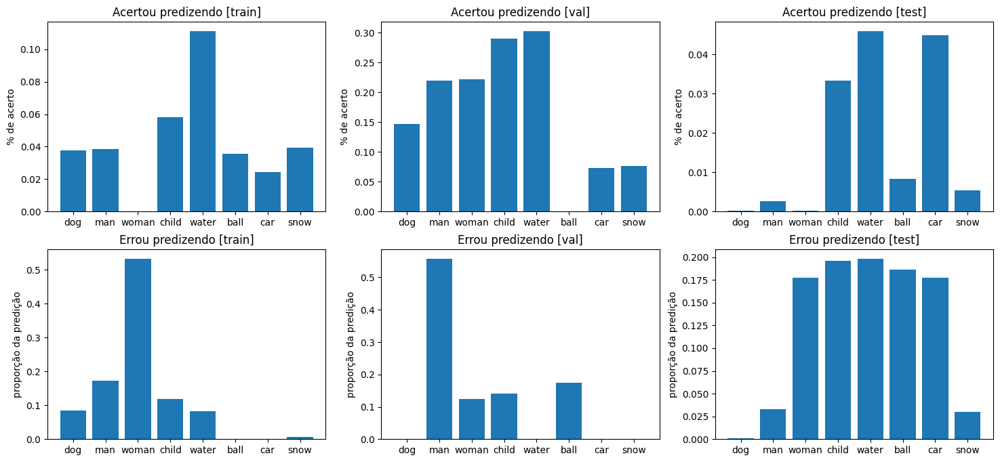


Quantidade de labels em cada conjunto: 
Treino   :  (array([0, 1, 2, 3, 4, 5, 6, 7]), array([80, 80, 83, 70, 81, 86, 82, 78]))
Validação:  (array([0, 1, 2, 3, 4, 5, 6, 7]), array([80, 80, 83, 70, 81, 86, 82, 78]))
Teste    :  (array([0, 1, 2, 3, 4, 5, 6, 7]), array([80, 80, 83, 70, 81, 86, 82, 78]))


In [14]:
plot_acc_per_class(resnet_model,(train_loader,val_loader,test_loader))

Bom, vamos ver os cams pra ter uma ideia do que está acontecendo

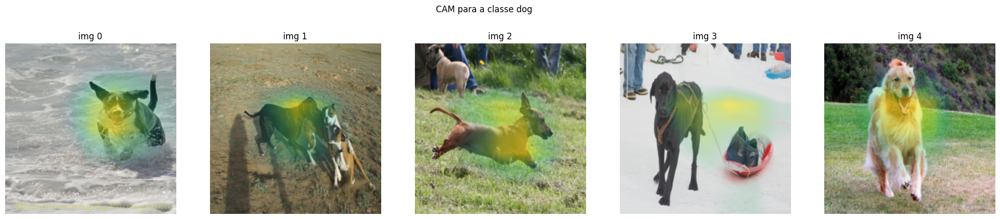

    0 --- true: dog        pred: dog        caption: A black and white dog runs through the white water at a beach .
    1 --- true: dog        pred: dog        caption: A black dog and two brown and white dogs are romping in the mud .
    2 --- true: dog        pred: dog        caption: A small dog running in grass .
    3 --- true: dog        pred: dog        caption: A black dog wearing a harness is pulling a sled .
    4 --- true: dog        pred: water      caption: Dog running in a field .





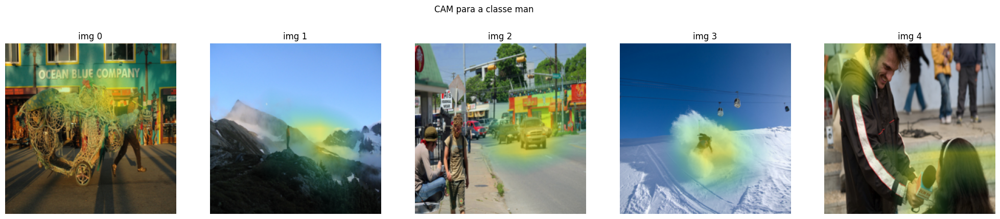

    0 --- true: man        pred: man        caption: Man pulling a cart in the street .
    1 --- true: man        pred: man        caption: Man standing at the top of a mountain at dusk .
    2 --- true: man        pred: man        caption: A man sitting on the left near a man walking along the side of a street with colorful buildings .
    3 --- true: man        pred: car        caption: A man skis down the hill , spraying snow in the air , ski lifts in the background .
    4 --- true: man        pred: woman      caption: A man holding a microphone up for a woman .





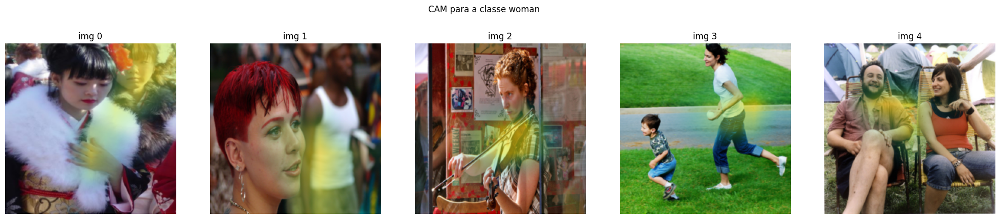

    0 --- true: woman      pred: woman      caption: an asian woman holds her fur scarf .
    1 --- true: woman      pred: woman      caption: A closeup of a woman with short red hair .
    2 --- true: woman      pred: woman      caption: The woman is holding a violin .
    3 --- true: woman      pred: woman      caption: a woman holding a small ball chasing after a small boy .
    4 --- true: woman      pred: woman      caption: A woman is smiling at the bearded man sitting in the lawn chair next to her .





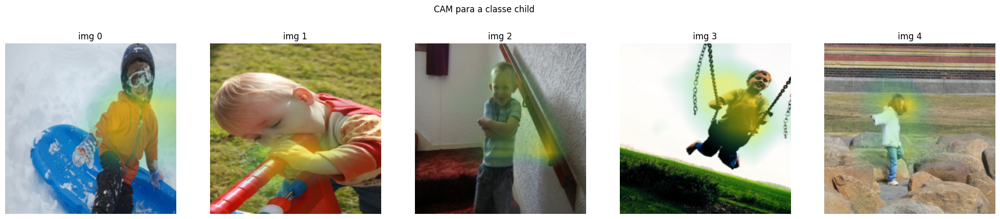

    0 --- true: child      pred: child      caption: A child in orange poses in the snow riding a blue sled .
    1 --- true: child      pred: child      caption: A child plays with a toy in the grass .
    2 --- true: child      pred: child      caption: A child is standing beside a banister on a red carpeted stair .
    3 --- true: child      pred: water      caption: A child at the height of a swing .
    4 --- true: child      pred: child      caption: A child walking on rocks .





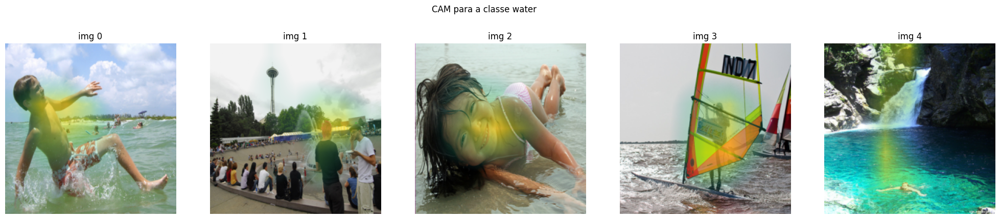

    0 --- true: water      pred: water      caption: A boy in orange and white swimming trunks is falling into water at a beach or lake .
    1 --- true: water      pred: water      caption: Many people are sitting and observing or going into a water attraction .
    2 --- true: water      pred: water      caption: a smiling toddler in a pink swimsuit is laying in the water .
    3 --- true: water      pred: water      caption: This person , whose board displays an orange and yellow sail , is sailing through the water .
    4 --- true: water      pred: water      caption: A person swims in a body of water with a waterfall .





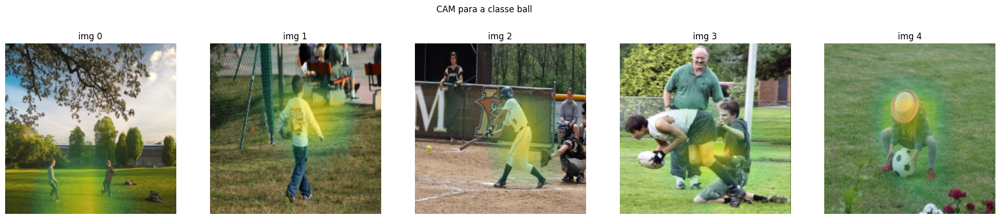

    0 --- true: ball       pred: ball       caption: Two boys kick around a ball in a meadow .
    1 --- true: ball       pred: ball       caption: A boy walks with a ball tucked under his arm .
    2 --- true: ball       pred: ball       caption: A batter swings at a ball .
    3 --- true: ball       pred: ball       caption: A boy holding a ball falls down in front of another boy who has his arms reaching out while an older man in a green shirt smiles and watches .
    4 --- true: ball       pred: ball       caption: The little girl wearing a pink hat is bending down to pick up a soccer ball .





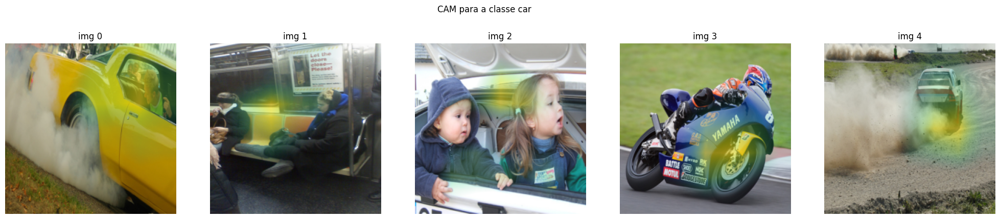

    0 --- true: car        pred: car        caption: A yellow car , a man in it looking to the back where steam is coming out .
    1 --- true: car        pred: car        caption: Two women in winter clothes ride in a subway car with orange and yellow seats .
    2 --- true: car        pred: car        caption: Two small children sitting in the trunk of a car .
    3 --- true: car        pred: car        caption: A race car driver in a Yamaha bicycle is turning on a racetrack .
    4 --- true: car        pred: car        caption: A race car kicks up dust as it speeds down a gravel racetrack .





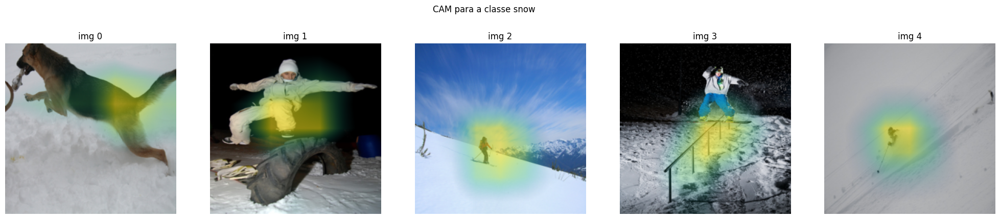

    0 --- true: snow       pred: snow       caption: A German Shephard plays in the snow .
    1 --- true: snow       pred: snow       caption: A person in the snow jumping over a tire .
    2 --- true: snow       pred: snow       caption: A skier in a red jacket and yellow backpack skis down a snow slope .
    3 --- true: snow       pred: snow       caption: The snow borader is riding a rail .
    4 --- true: snow       pred: snow       caption: A skier traveling downhill in deep snow .





In [15]:
n_perclass = 5
figsize = (5,5)
cam_imgs_per_class = get_cams_per_class(resnet_model,train_loader,n_perclass = n_perclass,target_layer=resnet_model.backbone[-1])

for class_idx, cams_imgs in enumerate(cam_imgs_per_class):
  fig,axs = plt.subplots(1,5,figsize=(figsize[0]*n_perclass,figsize[1]*1))

  ## mostra as imagens nos ax
  for img_count, (img_np,heatmap,caption,label,pred) in enumerate(cams_imgs):
    ax = axs[img_count]
    ax.imshow(img_np)
    ax.imshow(heatmap)
    ax.set_title(f"img {img_count}")
    ax.axis('off')
  fig.suptitle(f"CAM para a classe {label2class[class_idx]}")
  plt.show()

  ## printa as captions e labels e preds
  for img_count, (img_np,heatmap,caption,label,pred) in enumerate(cams_imgs):
    true_class = label2class[label]
    pred_class = label2class[pred]
    print(f"{img_count:5} --- true: {true_class:10} pred: {pred_class:10} caption: {caption}")
  print("\n\n")


Bom, com certeza os filtros estão melhores que na SimpleCNN. Mas como verificamos overfitting antes, vamos tentar ver o quanto isso influencia nos dados de teste

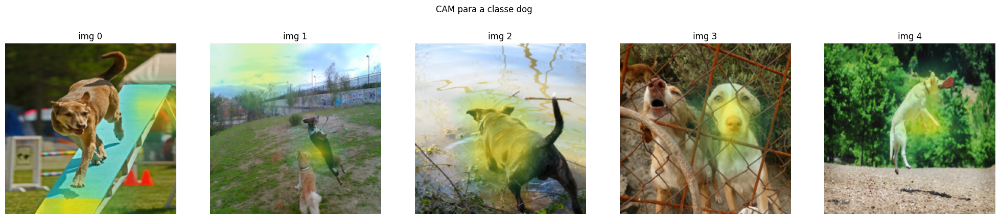

    0 --- true: dog        pred: woman      caption: A dog at a competition runs down a ramp .
    1 --- true: dog        pred: dog        caption: A dog stands on his hind legs while another dog looks on .
    2 --- true: dog        pred: dog        caption: A brown dog steps into murky water .
    3 --- true: dog        pred: woman      caption: The dogs are behind the fence .
    4 --- true: dog        pred: man        caption: A dog is catching a Frisbee i its mouth .





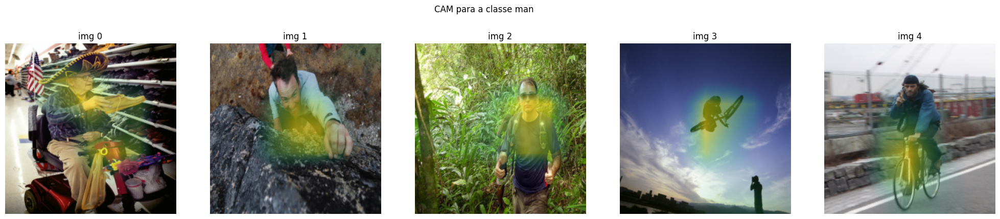

    0 --- true: man        pred: man        caption: An old man wearing a large hat , and riding in a motorized wheelchair , is picking out shoes at a store .
    1 --- true: man        pred: man        caption: A man climbs up a rock while others wait for their turns .
    2 --- true: man        pred: child      caption: A man hiking in the wilderness giving the camera a thumbs up .
    3 --- true: man        pred: man        caption: A man on a BMX bike catches massive air while someone is taking a picture
    4 --- true: man        pred: man        caption: A man with long hair riding a bicycle gives the peace sign .





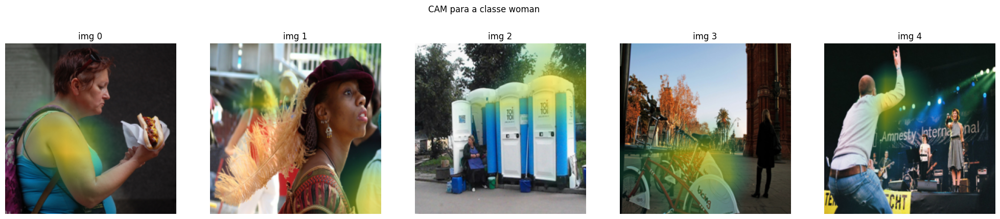

    0 --- true: woman      pred: woman      caption: An obese woman holding a chili dog in her right hand .
    1 --- true: woman      pred: man        caption: The woman is wearing a red hat that is decorated with a huge orange feather .
    2 --- true: woman      pred: car        caption: A woman , wearing an apron , sits outside three portable toilets .
    3 --- true: woman      pred: man        caption: A woman stands near a row of identical red bicycles .
    4 --- true: woman      pred: ball       caption: Woman onstage at Amnesty International event exchanges gestures with man offstage .





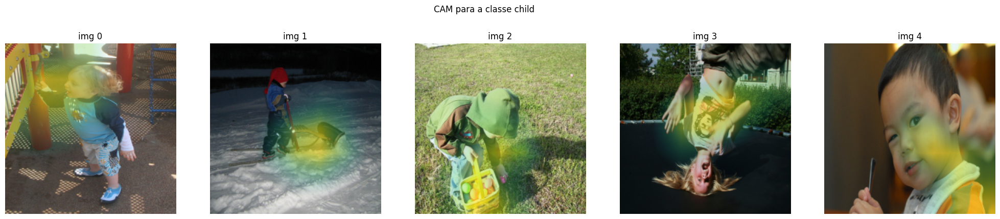

    0 --- true: child      pred: child      caption: A young child is playing with a stick at a playground .
    1 --- true: child      pred: child      caption: A young child plows snow manually .
    2 --- true: child      pred: dog        caption: A young child is picking up Easter eggs in the grass .
    3 --- true: child      pred: man        caption: A child jumps upside down on a trampoline .
    4 --- true: child      pred: child      caption: A tan-skinned child looking at the camera .





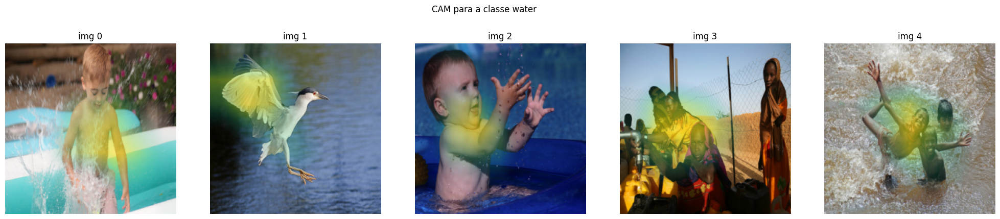

    0 --- true: water      pred: water      caption: The boy splashed the water .
    1 --- true: water      pred: water      caption: Bird hovers above water .
    2 --- true: water      pred: water      caption: A young boy catching a stream of water .
    3 --- true: water      pred: man        caption: Africans gather water at an outdoor tap .
    4 --- true: water      pred: water      caption: These three young boys are posing in a body of water .





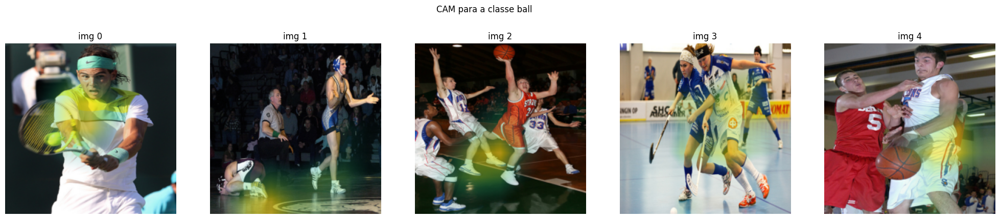

    0 --- true: ball       pred: ball       caption: A person holding a tennis racket hits a yellow tennis ball .
    1 --- true: ball       pred: child      caption: A wrestler in purple curls up in a ball while one in blue celebrates .
    2 --- true: ball       pred: ball       caption: Three basketball players in white are defending against the attacking player with the ball in orange .
    3 --- true: ball       pred: ball       caption: A female hockey player in blue is challenging the player in white for the ball .
    4 --- true: ball       pred: ball       caption: The basketball player in red is challenging the player in white for the ball .





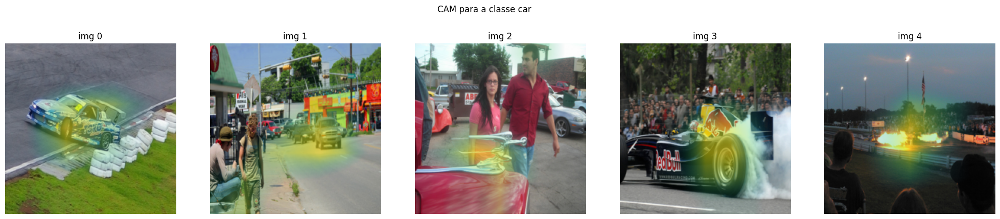

    0 --- true: car        pred: car        caption: a blue race car almost crashing into a wall of tires
    1 --- true: car        pred: man        caption: Two boys are on the sidewalk as cars pass by on the road .
    2 --- true: car        pred: car        caption: A couple walks past a car in a parking lot .
    3 --- true: car        pred: car        caption: Race car smoking very badly on the racetrack .
    4 --- true: car        pred: car        caption: People look at the flames coming from the cars at a drag race .





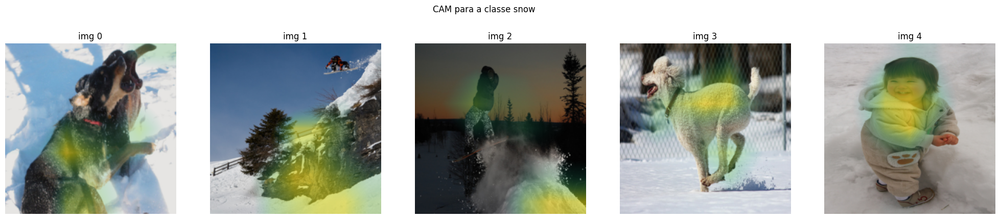

    0 --- true: snow       pred: dog        caption: animals in the snow
    1 --- true: snow       pred: snow       caption: A person on a snowboard jumps over a cliff in the snow .
    2 --- true: snow       pred: man        caption: A snowboarder flying off a snow drift with a colorful sky in the background .
    3 --- true: snow       pred: dog        caption: A white poodle is running in the snow , near a chain link fence .
    4 --- true: snow       pred: child      caption: A toddler in a beige suit is smiling whilst playing in the snow .





In [16]:
n_perclass = 5
figsize = (5,5)
cam_imgs_per_class = get_cams_per_class(resnet_model,test_loader,n_perclass = n_perclass,target_layer=resnet_model.backbone[-1])

for class_idx, cams_imgs in enumerate(cam_imgs_per_class):
  fig,axs = plt.subplots(1,5,figsize=(figsize[0]*n_perclass,figsize[1]*1))

  ## mostra as imagens nos ax
  for img_count, (img_np,heatmap,caption,label,pred) in enumerate(cams_imgs):
    ax = axs[img_count]
    ax.imshow(img_np)
    ax.imshow(heatmap)
    ax.set_title(f"img {img_count}")
    ax.axis('off')
  fig.suptitle(f"CAM para a classe {label2class[class_idx]}")
  plt.show()

  ## printa as captions e labels e preds
  for img_count, (img_np,heatmap,caption,label,pred) in enumerate(cams_imgs):
    true_class = label2class[label]
    pred_class = label2class[pred]
    print(f"{img_count:5} --- true: {true_class:10} pred: {pred_class:10} caption: {caption}")
  print("\n\n")


Parece que a coloração dos objetos ainda interfere e isso pode estar atrapalhando (por exemplo uma criança de camisa branca ser confundida com 'snow').

Apesar disso, existem vários casos que a rede desempenhou bem já que conseguiu achar até casos multilabel, como 'duas crianças brincando na água' (nesse exemplo ela prediz 'child', mas pela construção do dataset, seria 'water', mas a interpretação está ótima).